In [1]:
from lib.knn.__init__ import KNearestNeighbor
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.autograd import Variable
from lib.network import PoseNet, ConfNet, PoseNetRGBOnly
from lib.loss import Loss
from lib.transformations import euler_matrix, quaternion_matrix, quaternion_from_matrix
from datasets.linemod.dataset import PoseDataset as PoseDataset_linemod
import yaml
from PIL import Image
import numpy as np
import warnings
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")

/home/aquancva/DenseFusion/lib/transformations.py:1912: UserWarning: failed to import module _transformations
  warnings.warn('failed to import module %s' % name)


In [2]:
num_objects = 5
objlist = [2, 4, 5, 10, 11]
num_points = 500
iteration = 4
refine_start = False
bs = 1
dataset_config_dir = 'datasets/linemod/dataset_config'
output_result_dir = 'experiments/eval_result/linemod'
knn = KNearestNeighbor(1)

add_depth_to_output=True
true_depth=True

In [3]:
estimator = PoseNetRGBOnly(num_points = num_points, num_obj = num_objects)
model = 'trained_models/linemod/rgb_model_4_0.010808611272843284.pth'
estimator.load_state_dict(torch.load(model))
estimator.cuda();

In [4]:
dataset_root = "./datasets/linemod/Linemod_preprocessed"


testdataset = PoseDataset_linemod('eval', 
                              num_points, 
                              False, 
                              dataset_root, 
                              0.0, 
                              refine_start,
                              use_true_depth=true_depth,
                              objlist=objlist)
testdataloader = torch.utils.data.DataLoader(testdataset, batch_size=1, shuffle=False, num_workers=4)

Object 2 buffer loaded
Object 4 buffer loaded
Object 5 buffer loaded
Object 10 buffer loaded
Object 11 buffer loaded


In [5]:
sym_list = testdataset.get_sym_list()
num_points_mesh = testdataset.get_num_points_mesh()
criterion = Loss(num_points_mesh, sym_list)

In [6]:
diameter = []
meta_file = open('{0}/models_info.yml'.format(dataset_config_dir), 'r')
meta = yaml.load(meta_file)
for obj in objlist:
    diameter.append(meta[obj]['diameter'] / 1000.0 * 0.1)
print(diameter)

[0.024750624233, 0.017249224865, 0.020140358597000002, 0.016462758847999998, 0.017588933422000002]


In [7]:
success_count = [0 for i in range(num_objects)]
num_count = [0 for i in range(num_objects)]

In [11]:
def plot_points(pred, img_path):
    cam_cx = 325.26110
    cam_cy = 242.04899
    cam_fx = 572.41140
    cam_fy = 573.57043
    cam_scale = 1
    
    predicts = pred * 1000
    x = predicts[:, 0]
    y = predicts[:, 1]
    z = predicts[:, 2]
    
    dep = z * cam_scale
    pixel_x = x * cam_fx / dep + cam_cx
    pixel_y = y * cam_fy / dep + cam_cy

    image = Image.open(img_path)

    plt.figure(figsize=(20,10))
    plt.imshow(image)
    plt.scatter(pixel_x, pixel_y, s=2, c='r')
    plt.show()

No.0 Pass! Distance: 0.013768978144203888


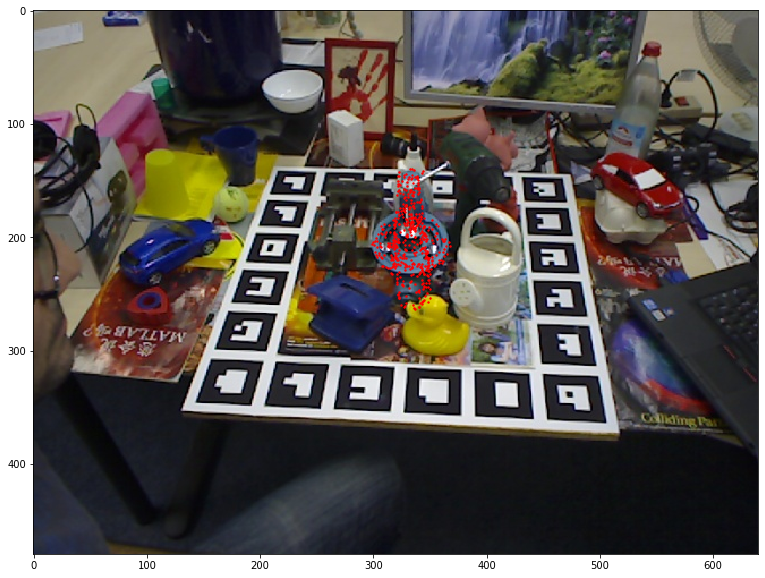

No.1 Pass! Distance: 0.016383162222431726


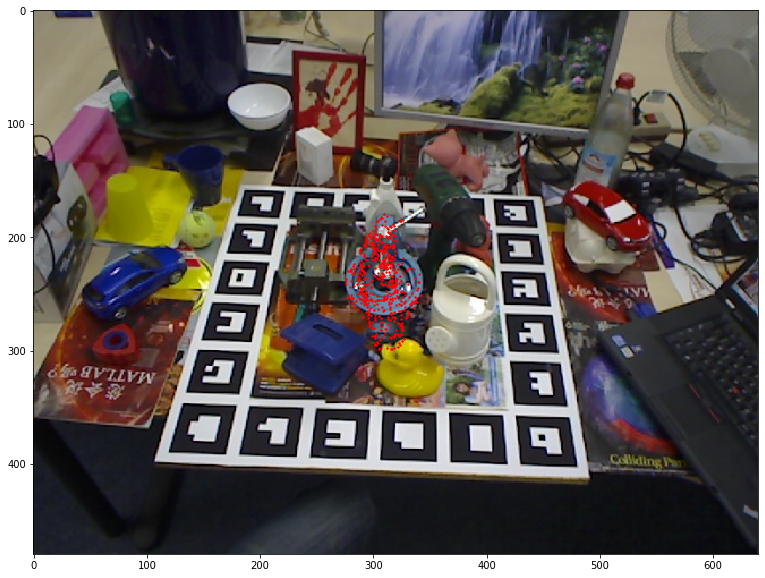

No.2 Pass! Distance: 0.018062584678595294


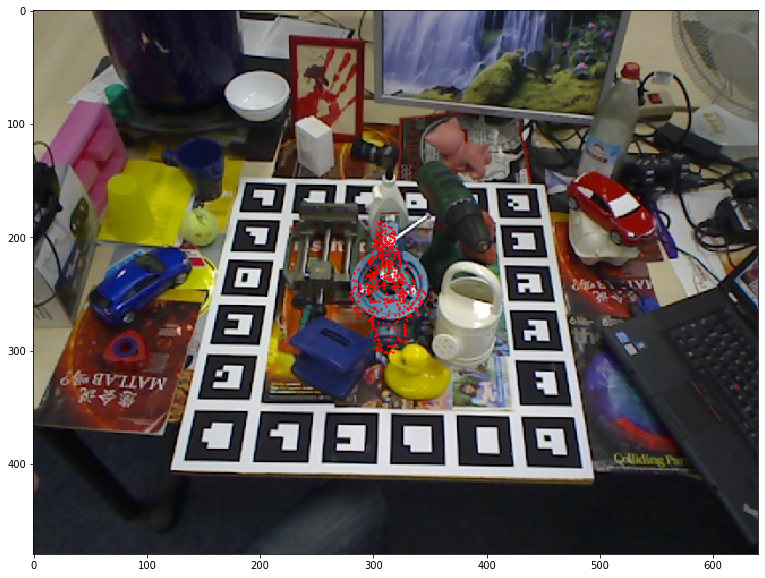

No.3 NOT Pass! Distance: 0.025710785557359887


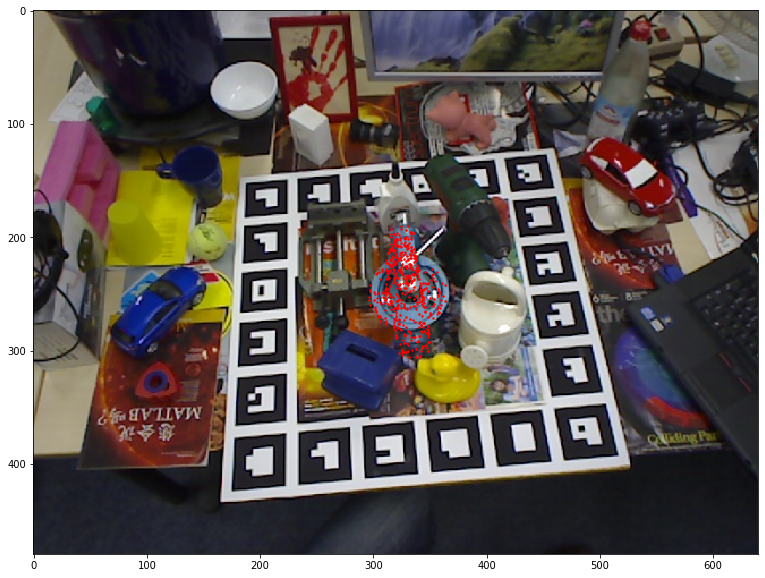

No.4 NOT Pass! Distance: 0.03225343962457025


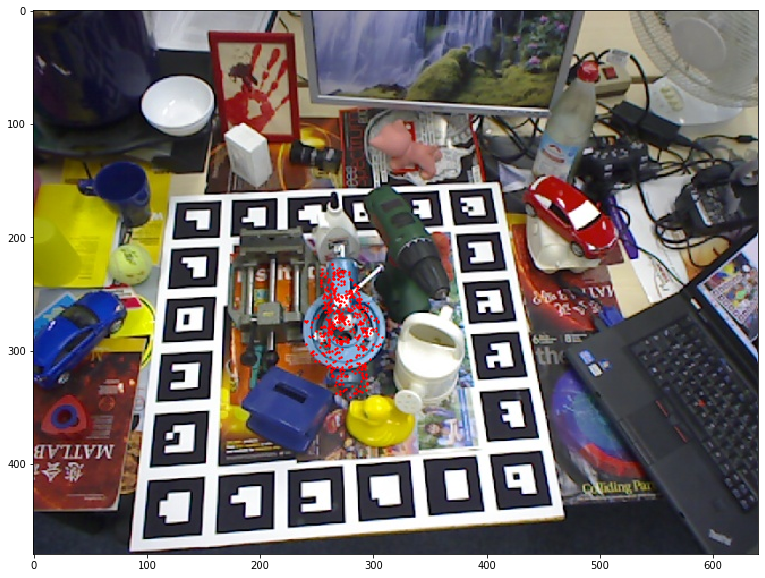

No.5 Pass! Distance: 0.014444410797901203


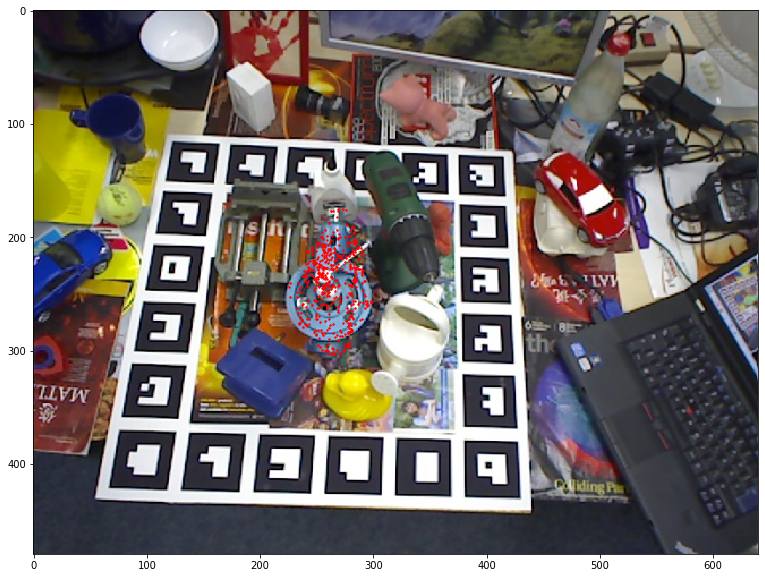

No.6 Pass! Distance: 0.008967180551070314


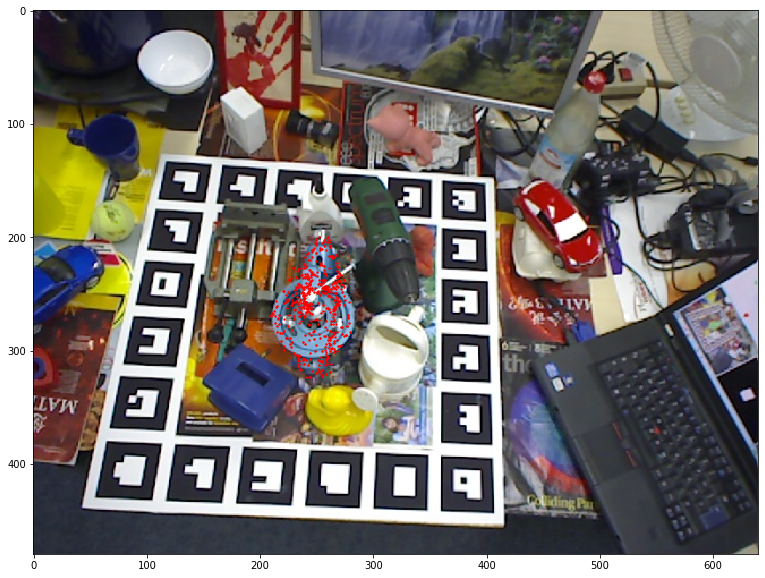

No.7 NOT Pass! Distance: 0.02817687923314625


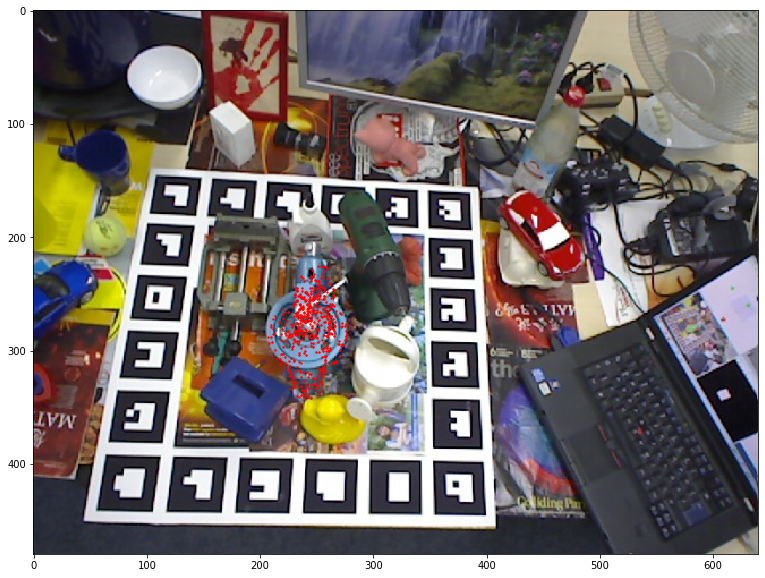

No.8 NOT Pass! Distance: 0.027689557371158004


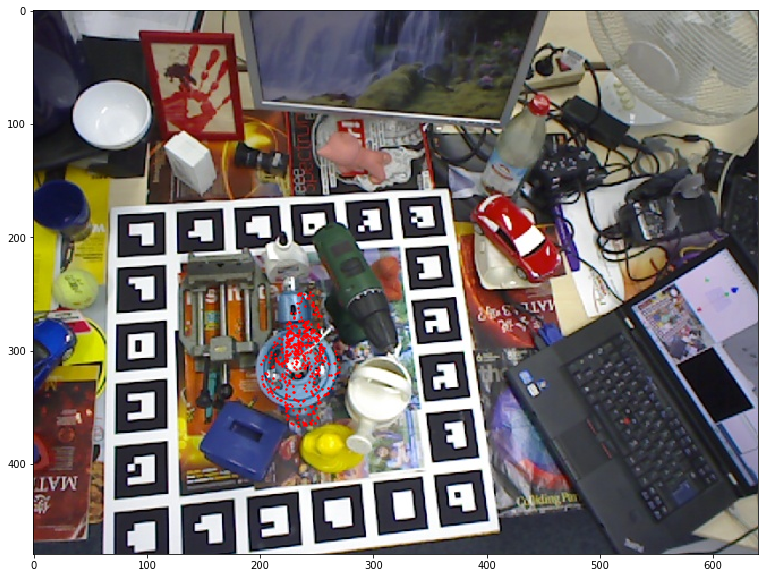

No.9 NOT Pass! Distance: 0.026958249486046262


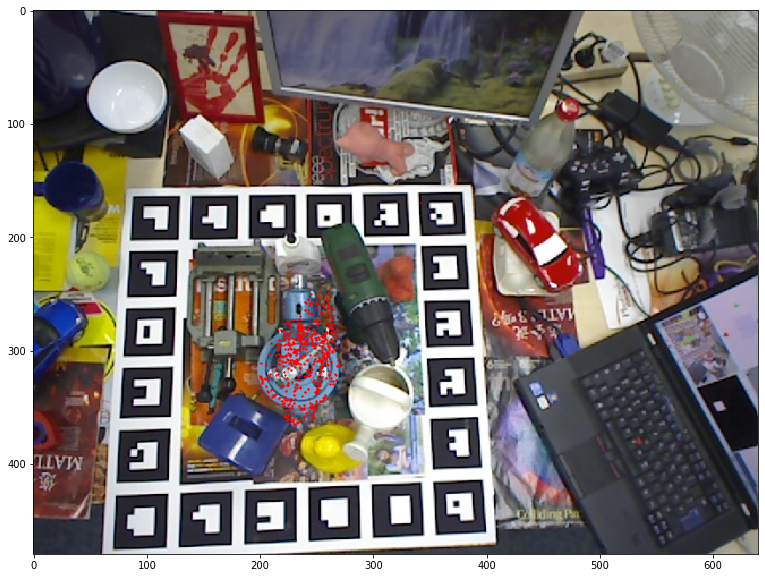

No.10 Pass! Distance: 0.012959544323733134


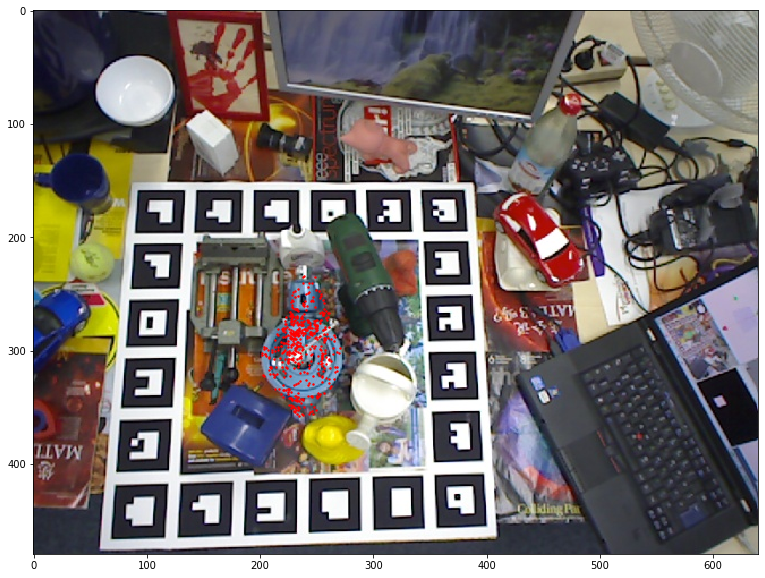

No.11 Pass! Distance: 0.01972828292508672


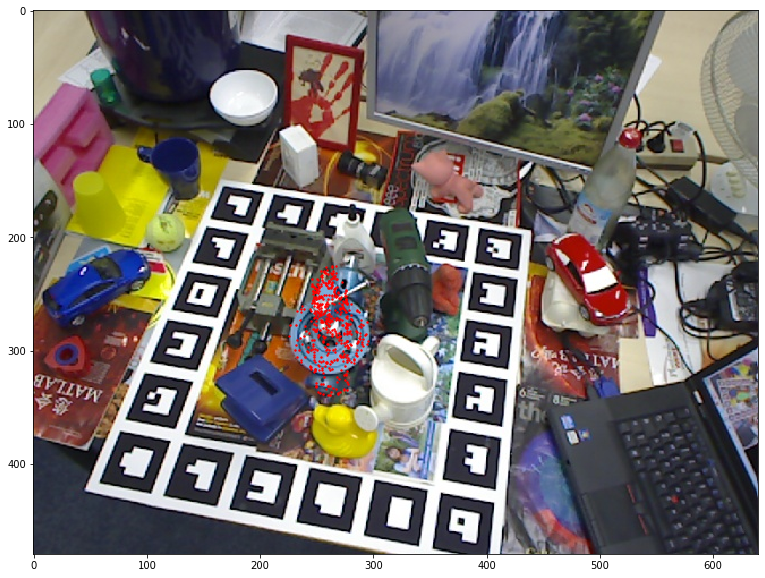

No.12 Pass! Distance: 0.012771077330942876


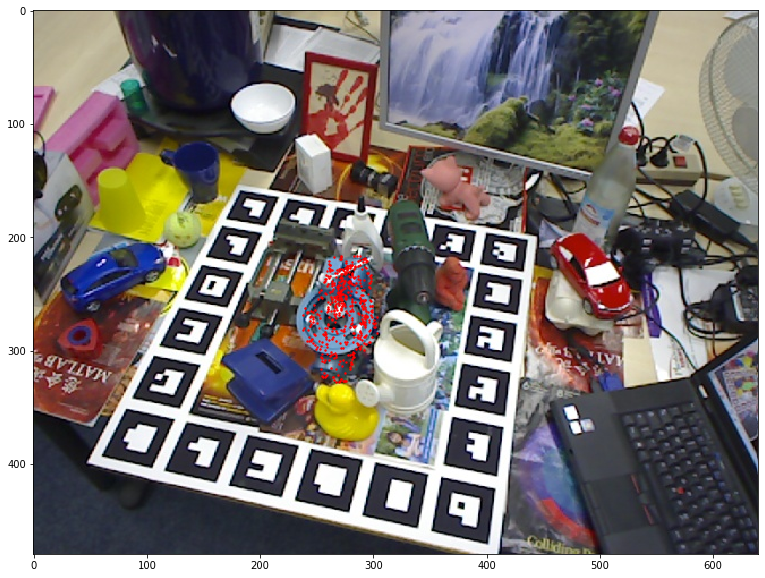

No.13 Pass! Distance: 0.017414803530658135


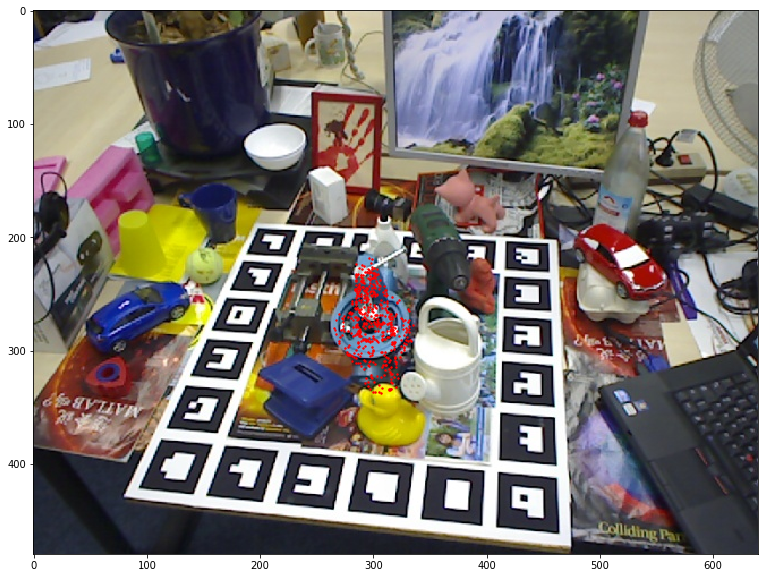

No.14 Pass! Distance: 0.012564630538103149


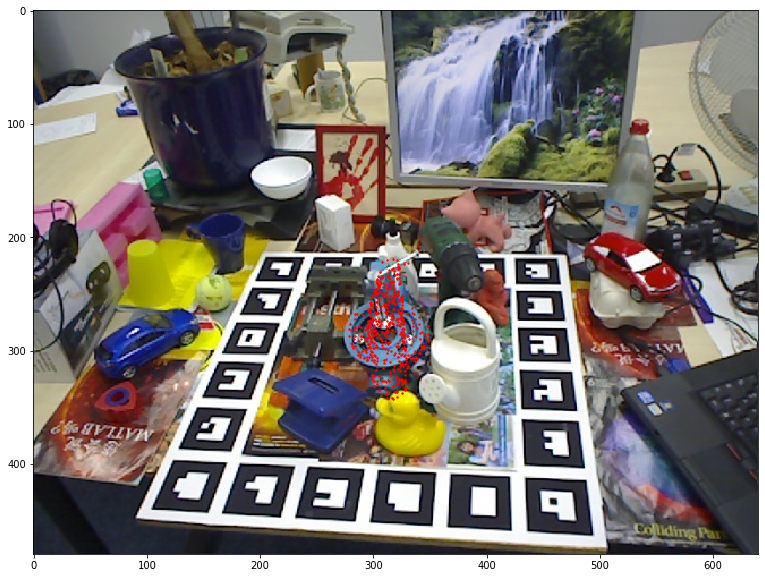

No.15 Pass! Distance: 0.017405233233446022


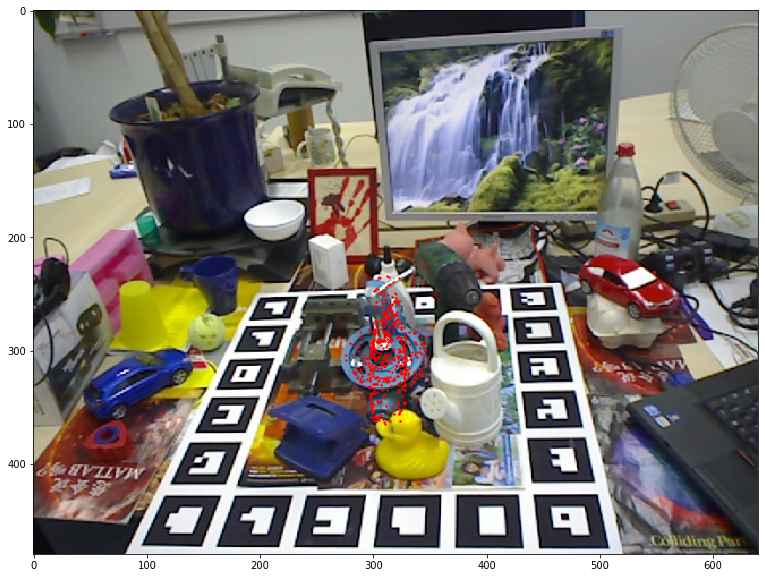

No.16 Pass! Distance: 0.013089686794339304


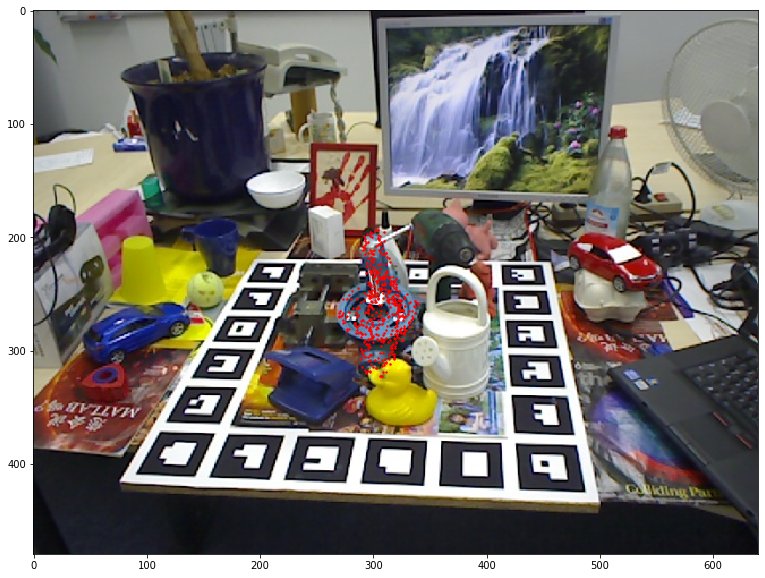

No.17 Pass! Distance: 0.013023820080543223


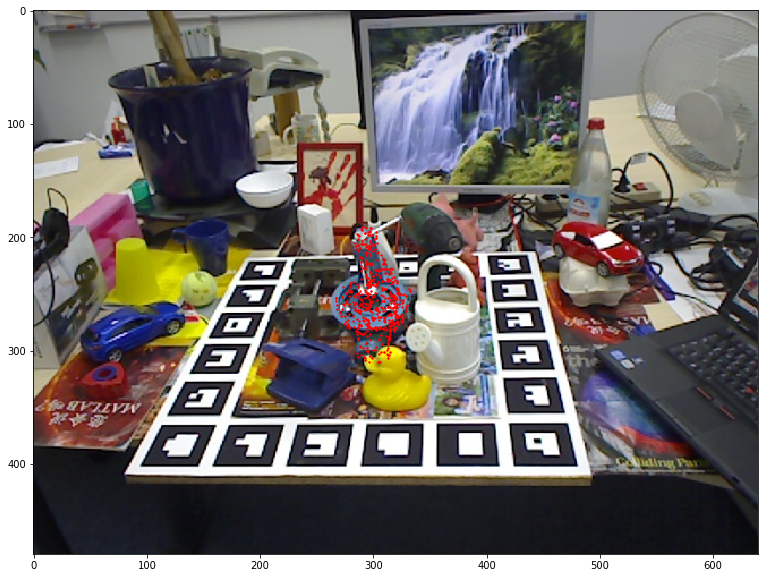

No.18 Pass! Distance: 0.022026588164380124


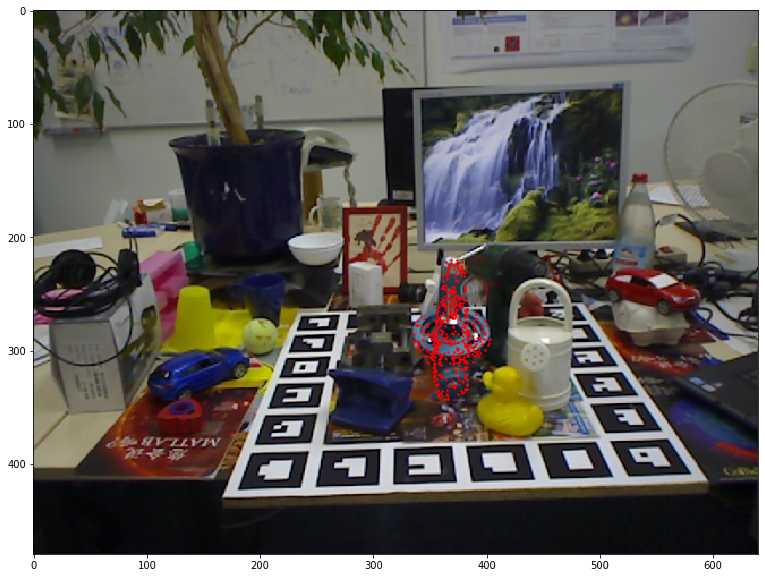

No.19 Pass! Distance: 0.015073126363217393


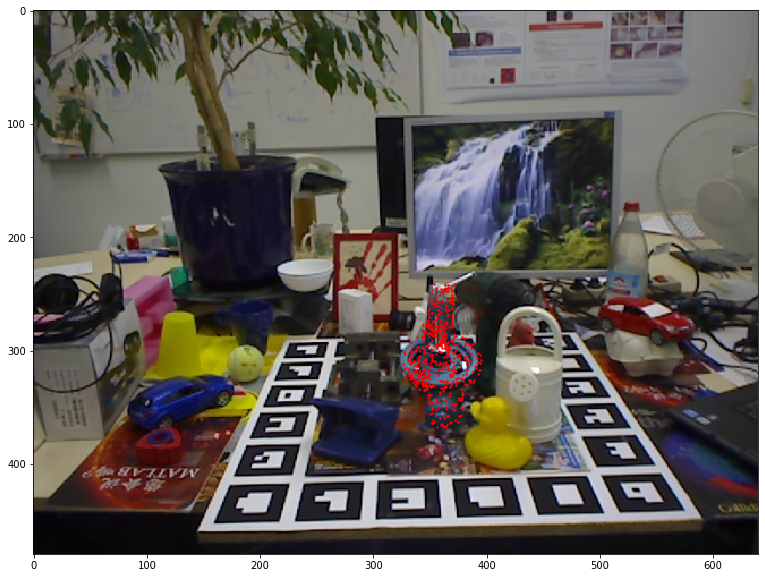

No.20 Pass! Distance: 0.008866116475656528


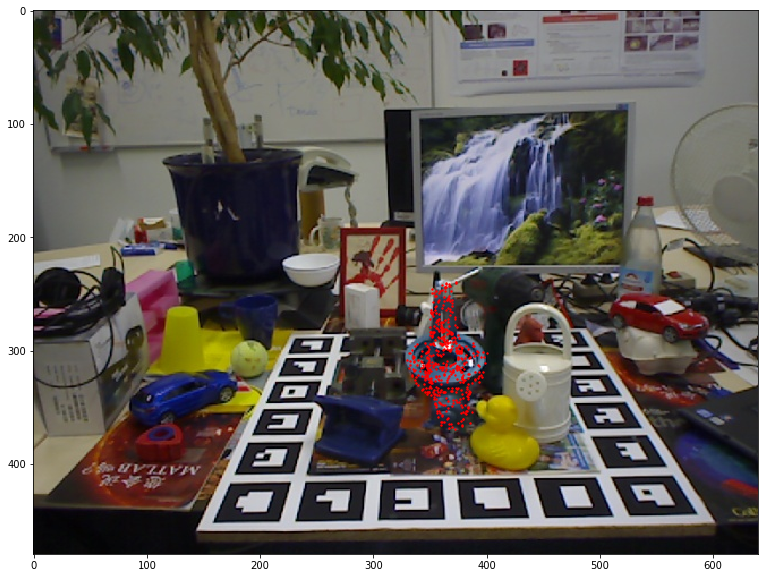

No.21 Pass! Distance: 0.008807623591746479


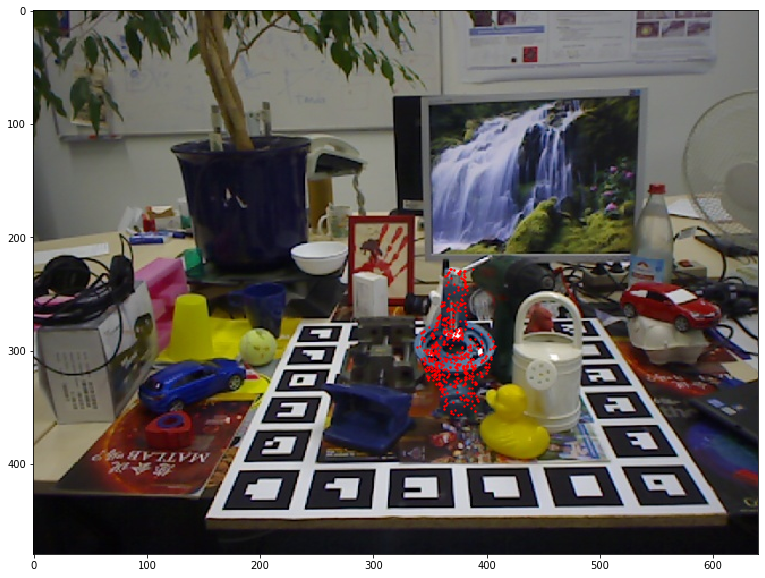

No.22 Pass! Distance: 0.012522773553672253


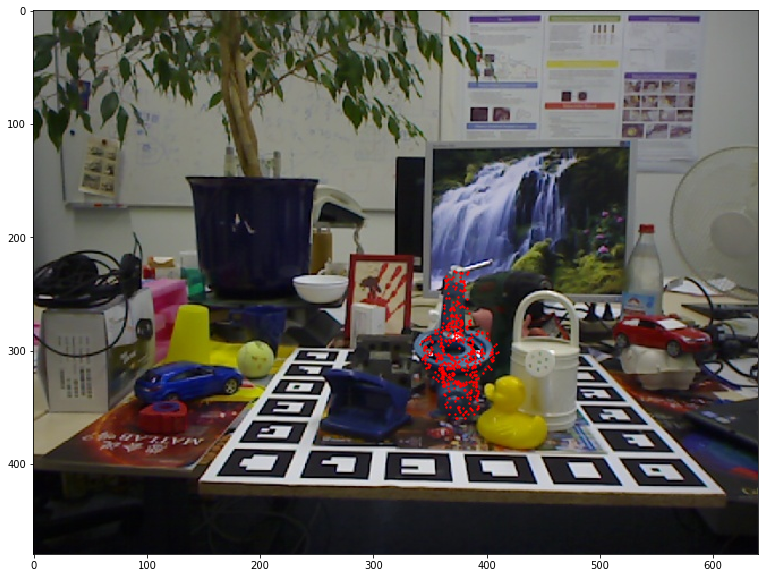

No.23 Pass! Distance: 0.011176073184237075


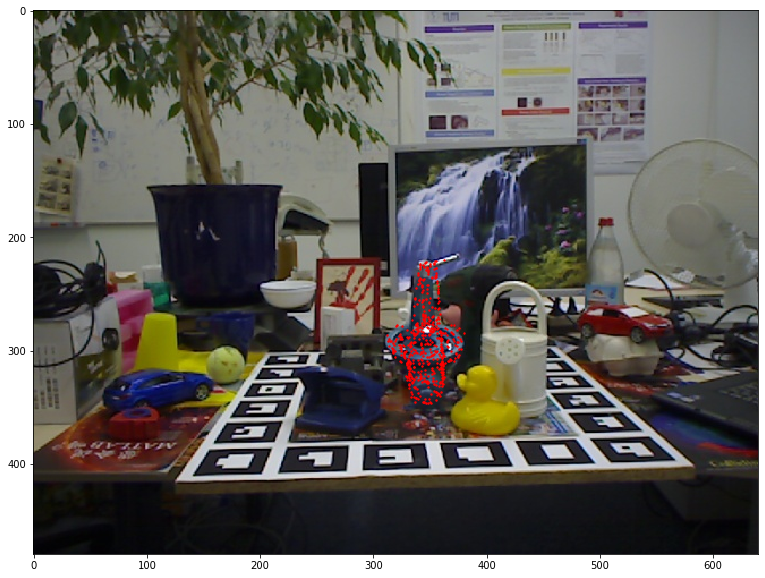

No.24 Pass! Distance: 0.009500310805629632


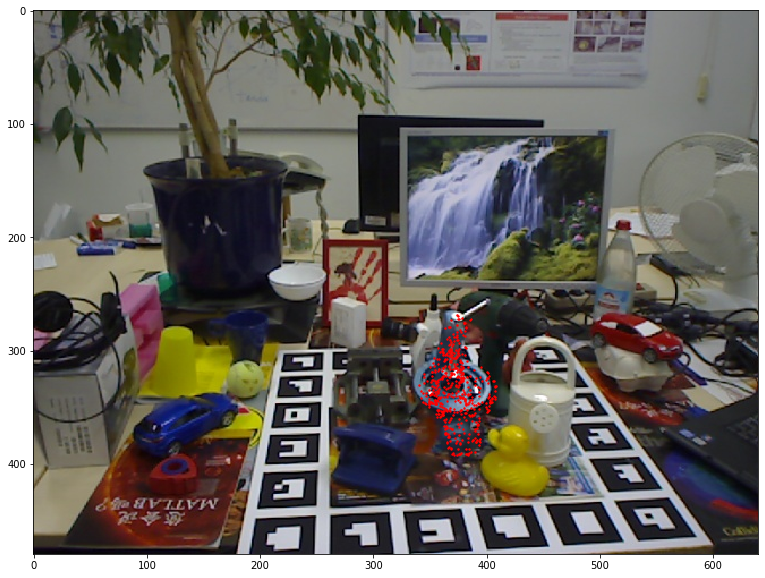

No.25 Pass! Distance: 0.016494675843491756


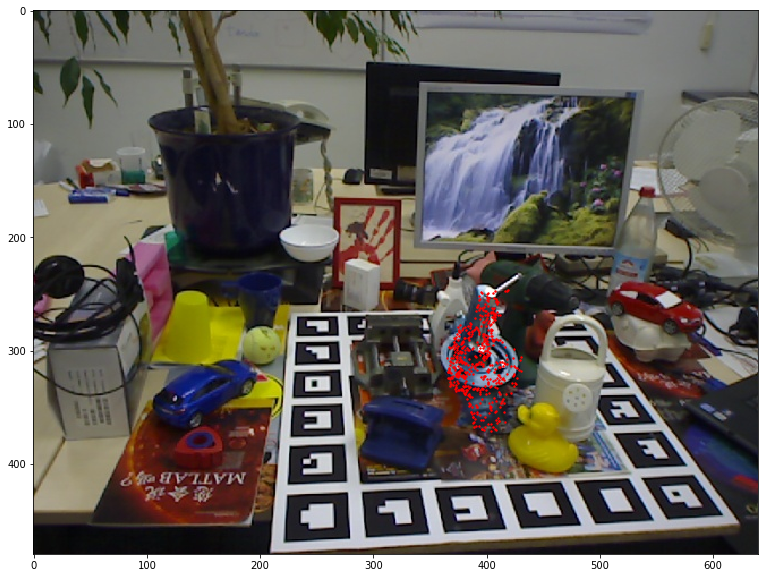

No.26 Pass! Distance: 0.009983279324879841


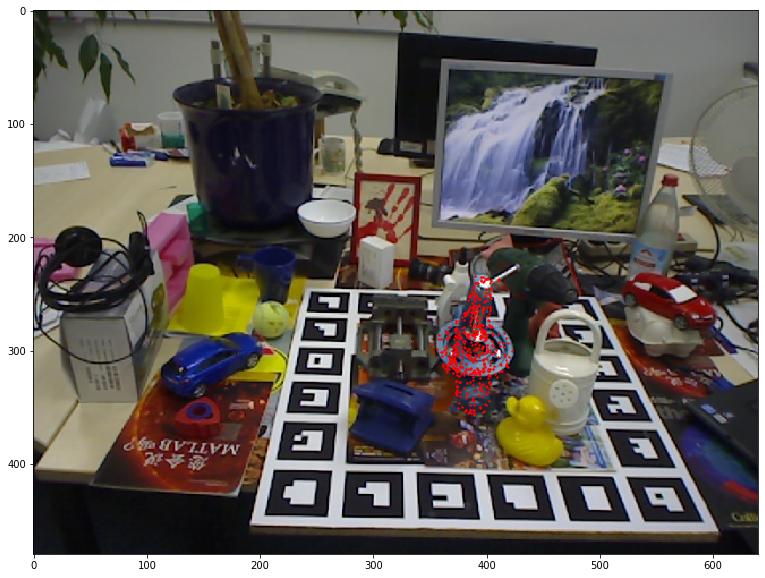

No.27 Pass! Distance: 0.006238597710792996


In [ ]:
fw = open('{0}/eval_result_logs.txt'.format(output_result_dir), 'w')

for i, data in enumerate(testdataloader, 0):
    points, choose, img, target, model_points, idx = data

    if len(points.size()) == 2:
        print('No.{0} NOT Pass! Lost detection!'.format(i))
        fw.write('No.{0} NOT Pass! Lost detection!\n'.format(i))
        continue
        
#     points[0, :, 2] = 0
    points, choose, img, target, model_points, idx = Variable(points).cuda(), \
                                                     Variable(choose).cuda(), \
                                                     Variable(img).cuda(), \
                                                     Variable(target).cuda(), \
                                                     Variable(model_points).cuda(), \
                                                     Variable(idx).cuda()
#     pred_r, pred_t, pred_c, emb = estimator(img, points, choose, idx)
    pred_r, pred_t, pred_c, emb = estimator(img, choose, idx)
#     pred_loss = confnet(emb)
                
    pred_r = pred_r / torch.norm(pred_r, dim=2).view(1, num_points, 1)
    pred_c = pred_c.view(bs, num_points)
    
    how_max, which_max = torch.max(pred_c, 1)
#     how_min, which_min = torch.min(pred_loss, 1) # The model predict the error of each pixel
   
    pred_t = pred_t.view(bs * num_points, 1, 3)

#     my_r = pred_r[0][which_min[0]].view(-1).cpu().data.numpy()
#     my_t = (points.view(bs * num_points, 1, 3) + pred_t)[which_min[0]].view(-1).cpu().data.numpy()
#     my_pred = np.append(my_r, my_t)
    
    my_r = pred_r[0][which_max[0]].view(-1).cpu().data.numpy()
    my_t = (points.view(bs * num_points, 1, 3) + pred_t)[which_max[0]].view(-1).cpu().data.numpy()
    my_pred = np.append(my_r, my_t)

    
    # Here 'my_pred' is the final pose estimation result ('my_r': quaternion, 'my_t': translation)
    
    model_points = model_points[0].cpu().detach().numpy()
    my_r = quaternion_matrix(my_r)[:3, :3]
    pred = np.dot(model_points, my_r.T) + my_t
    target = target[0].cpu().detach().numpy()
    
    
    
    if idx[0].item() in sym_list:
        pred = torch.from_numpy(pred.astype(np.float32)).cuda().transpose(1, 0).contiguous()
        target = torch.from_numpy(target.astype(np.float32)).cuda().transpose(1, 0).contiguous()
        inds = knn(target.unsqueeze(0), pred.unsqueeze(0))
        target = torch.index_select(target, 1, inds.view(-1) - 1)
        dis = torch.mean(torch.norm((pred.transpose(1, 0) - target.transpose(1, 0)), dim=1), dim=0).item()
    else:
        dis = np.mean(np.linalg.norm(pred - target, axis=1))
    
    if dis < diameter[idx[0].item()]:
        success_count[idx[0].item()] += 1
        print('No.{0} Pass! Distance: {1}'.format(i, dis))
        fw.write('No.{0} Pass! Distance: {1}\n'.format(i, dis))
    else:
        print('No.{0} NOT Pass! Distance: {1}'.format(i, dis))
        fw.write('No.{0} NOT Pass! Distance: {1}\n'.format(i, dis))
    num_count[idx[0].item()] += 1
    

    plot_points(pred, testdataset.list_rgb[i])
    
#     if (i + 1) % 10 == 0:
#         break
    
for i in range(num_objects):
    print('Object {0} success rate: {1}'.format(objlist[i], float(success_count[i]) / num_count[i]))
    fw.write('Object {0} success rate: {1}\n'.format(objlist[i], float(success_count[i]) / num_count[i]))
print('ALL success rate: {0}'.format(float(sum(success_count)) / sum(num_count)))
fw.write('ALL success rate: {0}\n'.format(float(sum(success_count)) / sum(num_count)))
fw.close()





- 2: "Bench Vise"
- 4: "camera"
- 5: "can"
- 6: "cat"
- 10: "eggbox"

In [37]:
target = target * 1000
x = target[:, 0]
y = target[:, 1]
z = target[:, 2]
depth = z * cam_scale
pixel_x = x * cam_fx / depth + cam_cx
pixel_y = y * cam_fy / depth + cam_cy

img = Image.open(testdataset.list_rgb[idx])

plt.figure(figsize=(20,10))
plt.imshow(img)
plt.scatter(pixel_x, pixel_y, s=2, c='r')